In [1]:
import numpy as np
import pandas as pd
import torch
from torch_geometric.data import Data
from torch_geometric.utils import to_networkx
from torch_geometric.utils import k_hop_subgraph
from torch_geometric.utils import remove_isolated_nodes

In [2]:
from tqdm import tqdm

In [3]:
all_pairs = pd.read_csv('all_pairs.csv')
all_pairs = [eval(x) for x in all_pairs.Target]
features = np.load('format_features.npy')[:,:-1]
features_with_class = np.load('format_features.npy')
edges = pd.read_csv('edges.csv')

In [4]:
edge_index = torch.tensor(edges.values)
x = torch.tensor(features)
full_graph = Data(x=x, edge_index=edge_index.t().contiguous())

In [5]:
def create_subgraph(node_idx, num_hops):
    subgraph = k_hop_subgraph(node_idx=node_idx, num_hops=num_hops, edge_index=full_graph.edge_index)
    nodes = subgraph[0][subgraph[0]!=node_idx]
    new_node_features = features[node_idx]
    nodes_features = torch.tensor(features[nodes]).float()
    edge_index = torch.tensor(np.array(edges[edges.Target.isin(nodes)&edges.Source.isin(nodes)]))
    removed = remove_isolated_nodes(edge_index=edge_index, num_nodes=len(features))
    edge_index = removed[0].t().contiguous()
    res = np.array([pd.Series(nodes).isin(all_pairs[node_idx])][0]).astype(int)
    data = Data(x=nodes_features, edge_index=edge_index)
    return (data, res, new_node_features)

In [6]:
def create_batch(elements, num_hops):
    graphs = []
    results = []
    features = []
    for i in elements:
        info = create_subgraph(int(i), num_hops)
        graphs.append(info[0])
        results.append(info[1])
        features.append(info[2])
    return(graphs, results, features)

In [7]:
hops_len = pd.DataFrame({'node':[], 'length':[]})
for i in range(2708):
    if len(all_pairs[i])>2:
        hops_len.loc[i] = [i,len(create_subgraph(i, 2)[1])]

hops_len = hops_len.astype(int)    

In [8]:
batches_of_node_idx = pd.DataFrame(hops_len.groupby('length').node.apply(np.array)).values

In [9]:
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
import torch.nn as nn
from torch_geometric.nn import avg_pool, global_add_pool
import torch_geometric.nn as pyg_nn
from torch_geometric.data import Data, DataLoader, NeighborSampler
from torch.nn import BatchNorm1d, Linear
from torch_geometric.nn.conv import GATConv

In [10]:
device = torch.device('cpu')
class Net(torch.nn.Module):
    def __init__(self, num_features):
        super(Net, self).__init__()
        self.conv1 = GCNConv(num_features, 1000)
        self.conv2 = GCNConv(1000, 700)
        self.convert = nn.Linear(num_features+700,100)
        self.convert1 = nn.Linear(100,1)
    def forward(self, data, features):
        x, edge_index, batch = data.x, data.edge_index, data.batch
        num_graphs = data.num_graphs
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = self.conv2(x, edge_index)
        x = F.relu(x)
        x = x.view((num_graphs,int(len(x)/num_graphs),700))
        features = torch.tensor([[a]*len(x[0]) for a in features.tolist()])
        x = torch.cat((x,features), dim=2)
        x = self.convert(x)
        x = F.relu(x)
        x = self.convert1(x)
        return x
    def get_pred(self, batch, batch_size):
        info = create_batch(batch, num_hops=2)
        loader = DataLoader(info[0], batch_size=batch_size)
        res = torch.tensor(info[1]).to(device)
        node_features = torch.tensor(info[2]).float().to(device)
        weight = torch.tensor([[(len(x)-float(sum(x)))/float(sum(x))] for x in res])
        preds = F.sigmoid(self.forward(next(iter(loader)), node_features.float()).squeeze(-1))
        return(preds, res)
    def computeLoss(self, batch, batch_size):
        info = create_batch(batch, num_hops=2)
        loader = DataLoader(info[0], batch_size=batch_size)
        res = torch.tensor(info[1]).to(device)
        node_features = torch.tensor(info[2]).float().to(device)
        weight = torch.tensor([[(len(x)-float(sum(x)))/float(sum(x))] for x in res])
        preds = self.forward(next(iter(loader)), node_features.float()).squeeze(-1)
        loss = nn.BCEWithLogitsLoss(weight=weight)
        loss_val = loss(preds, res.float())
        torch.cuda.empty_cache()
        return(loss_val)

In [11]:
model = Net(len(features[0]))

In [12]:
optimizer = torch.optim.Adam(model.parameters(), lr=5e-4)

In [13]:
train = range(0, 180, 2)
test = range(1, 181, 2)

In [14]:
from IPython.display import clear_output
import matplotlib.pyplot as plt
%matplotlib inline

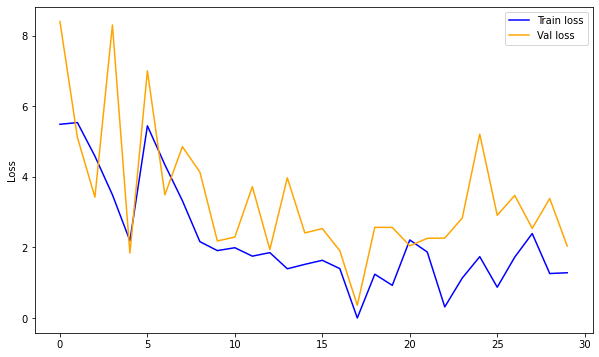

In [15]:
num_epoch = 30
n_batches_per_epoch = 20
n_validation_batches = 20
train_losses = []
val_losses = []
for epoch in range(num_epoch):
    train_loss= 0
    val_loss = 0
    model.train(True)
    order = np.random.permutation(train)
    for i in range(n_batches_per_epoch):
        optimizer.zero_grad()
        batch_indexes = order[0:0+2]
        x_batch = batches_of_node_idx[batch_indexes,[0]][0]
        x_batch = torch.tensor(np.array(x_batch).astype(int))
        loss_value = model.computeLoss( x_batch, batch_size=len(batches_of_node_idx[batch_indexes,[0]][0]))
        loss_value.backward()
        optimizer.step()
        train_loss += loss_value.item()
    train_loss /= (n_batches_per_epoch)
    train_losses.append(train_loss)
    model.train(False)
    for _ in range(n_batches_per_epoch):
        batch_indexes = order[0:0+1]+1
        x_batch = batches_of_node_idx[batch_indexes,[0]][0]
        x_batch = list(np.array(x_batch))
        loss_value = model.computeLoss( x_batch, batch_size=len(batches_of_node_idx[batch_indexes,[0]][0]))
        val_loss += loss_value.item()
    val_loss /= (n_validation_batches)
    val_losses.append(val_loss)
    clear_output()
    plt.figure(figsize = (10, 6))
    plt.plot(train_losses, label = 'Train loss', color = 'blue')
    plt.plot(val_losses, label = 'Val loss', color = 'orange')
    plt.legend()
    plt.ylabel('Loss')
    plt.show()

In [20]:
graph = k_hop_subgraph(node_idx=3, num_hops=3,relabel_nodes=True, edge_index=full_graph.edge_index)
graph_features = features_with_class[graph[0]][:, :-1]
graph_classes = features_with_class[graph[0]][:, -1]
graph_edges = graph[1]

In [21]:
order = np.random.permutation(range(2708))

In [22]:
order = order[~pd.Series(order).isin(graph[0])]

In [23]:
order

array([1803, 2689,  848, ...,  661,   74, 2671])

In [24]:
for i in tqdm(order):
    edge_index = graph_edges.t()
    x = torch.tensor(graph_features).float()
    data = Data(x=x, edge_index=edge_index.t().contiguous())
    loader = DataLoader([data], batch_size=1)
    nf = features[i].astype(float)
    new_class = features_with_class[i][-1]
    preds = F.sigmoid(model.forward(next(iter(loader)), torch.tensor([nf]).float())).squeeze(-1)[0]
    temp = (preds>0.85).int().nonzero()
    temp2 =torch.empty_like(temp)
    temp2[:, 0] = x.shape[0]
    temp2
    new_edges = torch.cat((temp, temp2), axis=1)
    new_edges = torch.cat((new_edges, new_edges[:, [1,0]]), axis=0)
    graph_classes = torch.cat((torch.tensor(graph_classes), torch.tensor([new_class]).int()))
    graph_edges = torch.cat((graph_edges, new_edges.t()), axis=1)
    graph_features = np.append(graph_features, [nf], axis=0)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2547/2547 [10:22<00:00,  4.09it/s]


In [25]:
r = graph_edges.t().numpy()
r.shape

(15970, 2)

In [26]:
import networkx as nx

In [27]:
G=nx.Graph()

In [28]:
G.add_edges_from(r)

In [29]:
colours = {0:'red', 1:'blue', 2:'green',3:'yellow', 4:'grey', 5:'orange',6:'black'}
labs = [colours[x] for x in list(graph_classes.int().numpy())]

In [30]:
len(labs)

2708

In [31]:
plt.figure(figsize = (100, 100))
nx.draw(G, node_color=labs)